# Install ISR
(skip if using local repo)

In [1]:
# !pip install ISR -y

# Predict

Download a sample image

In [1]:
!wget http://images.math.cnrs.fr/IMG/png/section8-image.png
!mkdir -p data/input/test_images
!mv *.png data/input/test_images

--2020-11-30 22:24:49--  http://images.math.cnrs.fr/IMG/png/section8-image.png
Resolving images.math.cnrs.fr (images.math.cnrs.fr)... 134.206.83.12
Connecting to images.math.cnrs.fr (images.math.cnrs.fr)|134.206.83.12|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 114590 (112K) [image/png]
Saving to: ‘section8-image.png’

section8-image.png  100%[===================>] 111.90K   370KB/s    in 0.3s    

2020-11-30 22:24:50 (370 KB/s) - ‘section8-image.png’ saved [114590/114590]



Load the image with PIL

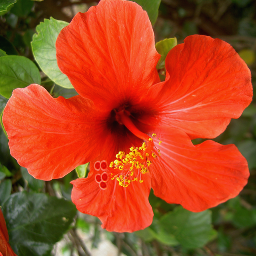

In [1]:
import numpy as np
from PIL import Image

img = Image.open('data/input/test_images/section8-image.png')
img

## Get predictions

### Create the model and run prediction
Create a RRDN or RDN model with the provided pre-trained weights, choose one

In [7]:
# Uncomment if using local repo
# import sys
# sys.path.append('..')
from ISR.models import RDN, RRDN

model = RDN(weights='noise-cancel')
# model = RRDN(weights='gans')
# model = RDN(weights='psnr-small')
# model = RDN(weights='psnr-large')

#### Baseline

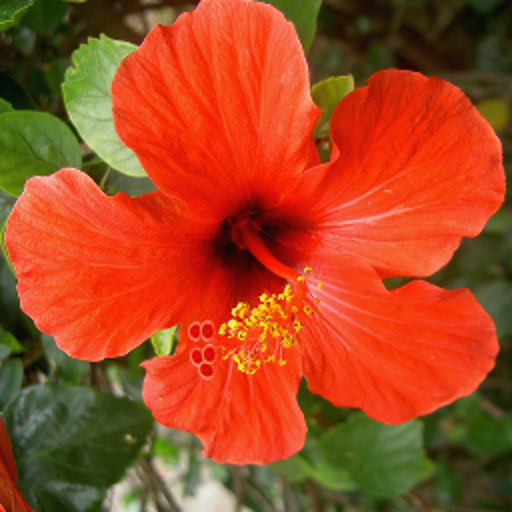

In [3]:
img.resize(size=(img.size[0]*2, img.size[1]*2), resample=Image.BICUBIC)

#### Prediction

0.1662125587463379


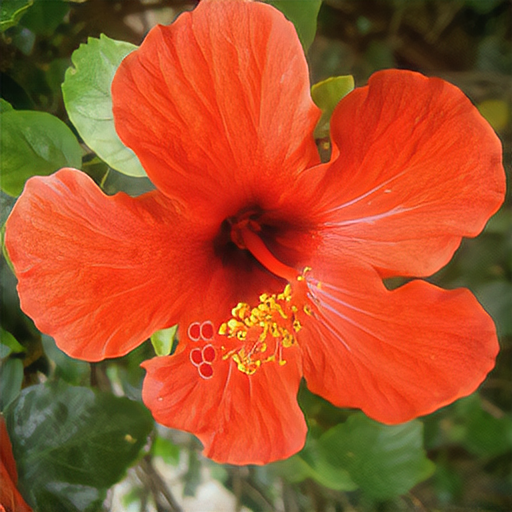

In [8]:
import time
start_time = time.time()
sr_img = model.predict(np.array(img))
print(time.time() - start_time)
Image.fromarray(sr_img)

### Usecase: upscaling noisy images

Compress the image into the jpeg format to introduce compression artefact and lose some information.

In [12]:
img.size

(256, 256)

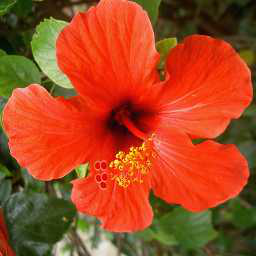

In [7]:
img.save('data/input/test_images/compressed.jpeg','JPEG', dpi=[300, 300], quality=50)
compressed_img = Image.open('data/input/test_images/compressed.jpeg')

compressed_img

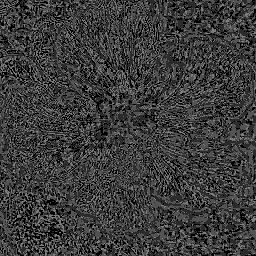

In [49]:
import numpy as np
Image.fromarray(np.absolute((np.array(img) - np.array(compressed_img)).mean(axis=-1).astype(np.uint8)[..., np.newaxis].repeat(3, -1) // 2))

In [48]:
np.absolute((np.array(img) - np.array(compressed_img)).mean(axis=-1).astype(int)[..., np.newaxis].repeat(3, -1)).min()

0

#### Baseline

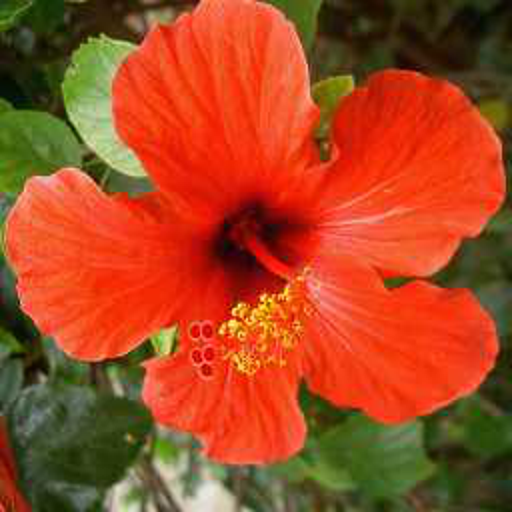

In [8]:
compressed_img.resize(size=(compressed_img.size[0]*2, compressed_img.size[1]*2), resample=Image.BICUBIC)

66076672/66071288 [==============================] - 5s 0us/step


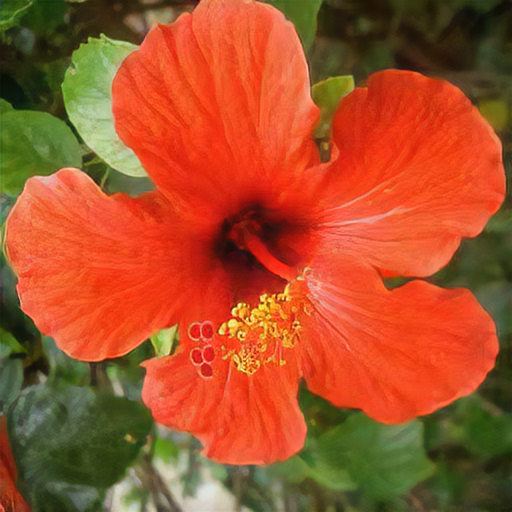

In [10]:
model = RDN(weights='noise-cancel')
sr_img = model.predict(np.array(compressed_img))
Image.fromarray(sr_img)

### Predictor Class
You can also use the predictor class to run the model on entire folders:

In [11]:
from ISR.predict import Predictor
!mkdir -p data/output
predictor = Predictor(input_dir='data/input/test_images/')
predictor.get_predictions(model=rdn, weights_path='weights/rdn-C6-D20-G64-G064-x2_ArtefactCancelling_epoch219.hdf5')

Creating output directory:
data/output/test_images


NameError: name 'rdn' is not defined

# Patch Selector Plan

Image pipeline:

input LR
compressed dir
output dir

compress the LR image to CR, and save it
decode just CR

save that image
decode CR + a 9th patch of LR, and get metrics
put metrics in a dataframe (image, patch_id, PSNR scaled, SSIM scaled, PSNR bicubic, SSIM bicubic, size of patch)

also create a "ground truth" dataset (image, patch_0, patch_1, .... patch_8) with SSIM

new "fully convolutional" model using pretrained imagenet tries to learn the best patch through
    classification
    decaying cumulative gain

eval with classification error / average SSIM (increase)

baseline is taking the patch with the most difference between the two in terms of SSIM bicubic

In [103]:
arr = np.array([1,2,32])
arrB = arr.copy()
arrB[2] = 0
arr

array([ 1,  2, 32])

In [4]:
import os
import numpy as np
import time
from skimage.metrics import structural_similarity as ssim
from PIL import Image


train_lr_dir = 'div2k/DIV2K_train_LR_bicubic/X2'
train_cr_dir = 'div2k/DIV2K_train_LR_bicubic/fixed_CR_50'
train_hr_dir = 'div2k/DIV2K_train_HR'

if not os.path.exists(train_cr_dir):
    os.mkdir(train_cr_dir)

for file in sorted(os.listdir(train_lr_dir)):
    if 'png' in file:
        img_id = file[:4]
        if int(img_id) % 50 == 0:
            print(img_id)
        filepath = os.path.join(train_lr_dir, file)
        lr_img = Image.open(filepath)
        cr_filepath = filepath.replace('png', 'jpeg')
        lr_img.save(cr_filepath,'JPEG', dpi=[300, 300], quality=50)
        cr_img = Image.open(cr_filepath)
        
        cr_img_np = np.array(cr_img)
        lr_img_np = np.array(lr_img)
                
        split = 3
        h, w, _ = lr_img_np.shape
        
        h_subsize = h // split
        w_subsize = w // split
        for h_block in range(split):
            for w_block in range(split):
                # patch resolution
                pr_img_np = cr_img_np.copy()
                pr_img_np[
                    h_block * h_subsize:(h_block + 1) * h_subsize,
                    w_block * w_subsize:(w_block + 1) * w_subsize
                ] = lr_img_np[
                    h_block * h_subsize:(h_block + 1) * h_subsize,
                    w_block * w_subsize:(w_block + 1) * w_subsize
                ]
                
                pr_img = Image.fromarray(pr_img_np)
                pr_id = h_block * split + w_block
                pr_filepath = os.path.join(train_cr_dir, file.replace('.png', '_' + str(pr_id) + '.png'))
                pr_img.save(pr_filepath)

0050
0100
0150
0200
0250
0300
0350
0400
0450
0500
0550
0600
0650
0700
0750
0800


In [ ]:
from ISR.predict import Predictor
import os
from ISR.models import RDN

model = RDN(weights='noise-cancel')

def predict_on_dir(input_dir):
    output_dir = input_dir + '_x2'
    if not os.path.exists(output_dir):
        os.mkdir(output_dir)
    predictor = Predictor(input_dir=input_dir, output_dir=output_dir)
    predictor.get_predictions(model=model, weights_path='rdn-C6-D20-G64-G064-x2_ArtefactCancelling_epoch219.hdf5')

# predict_on_dir(train_cr_dir)
predict_on_dir(train_lr_dir)

In [254]:
import os
import numpy as np
import time
from skimage.metrics import structural_similarity as ssim
from PIL import Image


train_lr_dir = 'div2k/DIV2K_train_LR_bicubic/X2'
train_cr_dir = 'div2k/DIV2K_train_LR_bicubic/fixed_CR_50'
train_hr_dir = 'div2k/DIV2K_train_HR'

def compute_data_dict(filelist, data_dict):
    for file in filelist:
        if 'png' in file:
            img_id = file[:4]
            if int(img_id) % 50 == 0:
                print(img_id)

            curr_dict = {}
            hr_img = Image.open(os.path.join(train_hr_dir, file.replace('x2', '')))
            hr_img_np = np.array(hr_img)

            filepath = os.path.join(train_lr_dir, file)
            lr_img = Image.open(filepath)
            cr_filepath = os.path.join(train_cr_dir, file.replace('png', 'jpeg'))
            cr_img = Image.open(cr_filepath)
            img_size = os.path.getsize(filepath)
            cr_img_size = os.path.getsize(cr_filepath)

            if not os.path.exists(os.path.join(train_cr_dir + '_x2', file.replace('png', 'jpeg'))):
                continue
            cr_img_np_x2 = np.array(Image.open(os.path.join(train_cr_dir + '_x2', file.replace('png', 'jpeg'))))
            lr_img_np_x2 = np.array(Image.open(os.path.join(train_lr_dir + '_x2', file)))
                        
            lr_ssim = ssim(lr_img_np_x2, hr_img_np, multichannel=True)
            cr_ssim = ssim(cr_img_np_x2, hr_img_np, multichannel=True)

            curr_dict['lr_filename'] = os.path.abspath(filepath)
            curr_dict['lr_ssim'] = lr_ssim
            curr_dict['lr_filesize'] = os.path.getsize(filepath)
            curr_dict['cr_ssim'] = cr_ssim
            curr_dict['cr_filesize'] = os.path.getsize(cr_filepath)

            split = 3
            pr_ssim_list = []
            naive_pr_ssim_list = []
            for pr_id in range(split ** 2):
                pr_img_np_x2 = np.array(Image.open(os.path.join(train_cr_dir + '_x2',
                    file.replace('.png', '_' + str(pr_id) + '.png'))))
                pr_img = Image.open(os.path.join(train_cr_dir,
                    file.replace('.png', '_' + str(pr_id) + '.png')))
                naive_pr_img_np_x2 = np.array(pr_img.resize(size=(pr_img.size[0]*2, pr_img.size[1]*2), resample=Image.BICUBIC))

                pr_ssim = ssim(pr_img_np_x2, hr_img_np, multichannel=True)
                naive_pr_ssim = ssim(naive_pr_img_np_x2, hr_img_np, multichannel=True)
                curr_dict['pr_' + str(pr_id) + '_ssim'] = pr_ssim
                curr_dict['naive_pr_' + str(pr_id) + '_ssim'] = naive_pr_ssim
                curr_dict['pr_' + str(pr_id) + '_filesize'] = os.path.getsize(
                    os.path.join(train_cr_dir,
                        file.replace('.png', '_' + str(pr_id) + '.png'))
                )

                pr_ssim_list.append(pr_ssim)
                naive_pr_ssim_list.append(naive_pr_ssim)

            curr_dict['pr_ssim_list'] = pr_ssim_list
            curr_dict['naive_pr_ssim_list'] = naive_pr_ssim_list
            curr_dict['best_patch'] = np.array(pr_ssim_list).argmax()
            curr_dict['best_patch_ssim'] = np.array(pr_ssim_list).max()
            curr_dict['naive_best_patch'] = np.array(naive_pr_ssim_list).argmax()
            curr_dict['naive_best_patch_ssim'] = pr_ssim_list[np.array(naive_pr_ssim_list).argmax()]

            data_dict[int(img_id)] = curr_dict

filelist = sorted(os.listdir(train_lr_dir))[200:]
num_workers = 16
num_files_per_worker = len(filelist) // num_workers

import pickle
"""
import multiprocessing

if __name__ == "__main__":
    manager = multiprocessing.Manager()
    return_dict = manager.dict()
    jobs = []
    for i in range(num_workers):
        sublist = filelist[i * num_files_per_worker:(i + 1) * num_files_per_worker]
        p = multiprocessing.Process(target=compute_data_dict, args=(sublist, return_dict))
        jobs.append(p)
        p.start()

    for proc in jobs:
        proc.join()
    
    with open('data_dict_v1.pkl', 'wb') as handle:
        pickle.dump(dict(return_dict), handle, protocol=pickle.HIGHEST_PROTOCOL)"""

with open('data_dict_v3.pkl', 'rb') as handle:
    data_dict = pickle.load(handle)
    
# compute_data_dict(filelist, data_dict)

In [255]:
len(list(data_dict.keys()))

287

In [256]:
import pandas as pd

base_df = pd.DataFrame.from_dict(data_dict, orient='index').sort_index()
base_df.tail()

,lr_filename,lr_ssim,lr_filesize,cr_ssim,cr_filesize,pr_0_ssim,naive_pr_0_ssim,pr_0_filesize,pr_1_ssim,naive_pr_1_ssim,...,pr_7_filesize,pr_8_ssim,naive_pr_8_ssim,pr_8_filesize,pr_ssim_list,naive_pr_ssim_list,best_patch,best_patch_ssim,naive_best_patch,naive_best_patch_ssim
283,/home/ubuntu/ucmsc34706/image-super-resolution...,0.742221,1187510,0.682633,81743,0.683498,0.715380,925605,0.684919,0.719585,...,915779,0.695963,0.732046,904469,"[0.6834984303417914, 0.6849194620961944, 0.687...","[0.7153801743926818, 0.7195853774295488, 0.726...",7,0.697231,6,0.693683
284,/home/ubuntu/ucmsc34706/image-super-resolution...,0.858602,1261805,0.812405,90611,0.818736,0.876333,1035183,0.817969,0.877198,...,1031870,0.814782,0.871639,1042140,"[0.8187358332303495, 0.8179692657459242, 0.816...","[0.8763328600379866, 0.8771977283998015, 0.877...",3,0.819323,4,0.817757
285,/home/ubuntu/ucmsc34706/image-super-resolution...,0.827690,1115137,0.766376,84324,0.781205,0.776919,984347,0.780386,0.775253,...,997608,0.781486,0.780000,997584,"[0.781205317808039, 0.7803861275261114, 0.7805...","[0.77691880657216, 0.775253071194386, 0.775248...",3,0.783061,3,0.783061
286,/home/ubuntu/ucmsc34706/image-super-resolution...,0.801209,1261578,0.738639,90798,0.740847,0.800252,1041917,0.739630,0.798620,...,1046957,0.746429,0.808265,1056741,"[0.7408473655035216, 0.7396300741668019, 0.741...","[0.8002523576677287, 0.7986197575753186, 0.800...",8,0.746429,5,0.745723
287,/home/ubuntu/ucmsc34706/image-super-resolution...,0.876874,1047111,0.846271,73956,0.844193,0.866907,788630,0.843791,0.866939,...,788538,0.851307,0.875296,794393,"[0.8441928401970004, 0.8437906096111442, 0.842...","[0.8669071271115554, 0.8669387381099743, 0.864...",8,0.851307,7,0.850764


In [202]:
(base_df["best_patch"] == base_df["naive_best_patch"]).sum(), (base_df.iloc[-20:]["best_patch"] == base_df.iloc[-20:]["naive_best_patch"]).sum()

(39, 5)

In [204]:
base_df['best_patch']

200    4
201    7
202    1
203    2
204    3
      ..
291    6
292    4
293    5
294    4
295    7
Name: best_patch, Length: 96, dtype: int64

In [266]:
from keras.preprocessing.image import ImageDataGenerator
from keras.models import Sequential
from keras.layers import Conv2D, MaxPooling2D
from keras.layers import Activation, Dropout, Flatten, Dense


batch_size = 16

train_datagen = ImageDataGenerator(
    featurewise_center=False,
    featurewise_std_normalization=False,
    preprocessing_function=preprocess_input,
    rotation_range=0,
    width_shift_range=0.02,
    height_shift_range=0.02,
    rescale=1./255,
    shear_range=0.02,
    zoom_range=0.02,
    horizontal_flip=False,
    fill_mode='nearest'
)

test_datagen = ImageDataGenerator(
    preprocessing_function=preprocess_input,
    rescale=1./255
)

def to_onehot(arr):
    # return str(np.random.choice(np.arange(len(arr))))
    return str(np.array(arr).argmax())
#     label = [0] * len(arr)
#     label[np.random.choice(np.arange(len(arr)))] = 1
#     # label[np.array(arr).argmax()] = 1
#    return label

base_df['label'] = base_df['pr_ssim_list'].apply(to_onehot)
train_df = base_df[base_df.index < 250]
test_df = base_df[(base_df.index >= 250) | ((base_df.index < 210) & (base_df.index >= 190))]

train_generator = train_datagen.flow_from_dataframe(
    train_df,
    x_col='lr_filename',
    y_col='label',
    target_size=(224, 224),
    color_mode='rgb',
    class_mode='categorical',
    batch_size=batch_size)

# this is a similar generator, for validation data
validation_generator = test_datagen.flow_from_dataframe(
    test_df,
    x_col='lr_filename',
    y_col='label',
    target_size=(224, 224),
    color_mode='rgb',
    class_mode='categorical',
    batch_size=batch_size)

Found 249 validated image filenames belonging to 9 classes.
Found 58 validated image filenames belonging to 9 classes.


In [267]:
from tensorflow.keras.applications.resnet_v2 import ResNet50V2, preprocess_input
from tensorflow.keras.preprocessing import image
from tensorflow.keras.models import Model
from keras.layers import Conv2D, MaxPooling2D, GlobalAveragePooling2D, Flatten, Activation
import numpy as np
import keras
# model = Sequential()
# model.add(Conv2D(32, (3, 3), input_shape=(3, 150, 150)))
# model.add(Activation('relu'))
# model.add(MaxPooling2D(pool_size=(2, 2)))

# model.add(Conv2D(32, (3, 3)))
# model.add(Activation('relu'))
# model.add(MaxPooling2D(pool_size=(2, 2)))

# model.add(Conv2D(64, (3, 3)))
# model.add(Activation('relu'))
# model.add(MaxPooling2D(pool_size=(2, 2)))

# model.add(Flatten())  # this converts our 3D feature maps to 1D feature vectors
# model.add(Dense(64))
# model.add(Activation('relu'))
# model.add(Dropout(0.5))

In [292]:
base_model = ResNet50V2(weights='imagenet', include_top=False, input_shape=(224,224,3))
x = base_model.output
"""
x = Conv2D(10, (3, 3), padding="same", activation='relu')(x)
x = MaxPooling2D(pool_size=(2,2))(x)
x = Conv2D(1, (3, 3), padding="same", activation='relu')(x)
x = Flatten()(x)
# predictions = Dense(2)(x)
x = Dense(9)(x)
"""
#x = Conv2D(1, (5, 5), activation='relu')(x)
x = GlobalAveragePooling2D()(x)
x = Flatten()(x)
x = Dense(9)(x)
predictions = Activation('softmax')(x)

In [293]:
print(predictions)

Tensor("activation_10/Softmax:0", shape=(None, 9), dtype=float32)


In [294]:
p_model = Model(inputs=base_model.input, outputs=predictions)  # base_model.get_layer('block4_pool').output)
# i.e. freeze all convolutional InceptionV3 layers
for layer in base_model.layers:
    layer.trainable = False

# compile the model (should be done *after* setting layers to non-trainable)
p_model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# img_path = 'data/input/test_images/section8-image.png'
# img = image.load_img(img_path, target_size=(224, 224))
# x = image.img_to_array(img)
# x = np.expand_dims(x, axis=0)
# x = preprocess_input(x)

# test_output = p_model.predict(x)
# test_output

In [295]:
from datetime import datetime

now = datetime.now()

p_model.fit_generator(
    train_generator,
    steps_per_epoch=len(train_df) // batch_size,
    epochs=2,
    validation_data=validation_generator,
    validation_steps=len(test_df) // batch_size)

p_model.save_weights('third_try_' + now.strftime("%Y_%m_%d_%H:%M") + '.h5')

Epoch 1/2
15/15 [==============================] - 11s 762ms/step - loss: 2.1577 - accuracy: 0.1845 - val_loss: 2.1511 - val_accuracy: 0.2083
Epoch 2/2
15/15 [==============================] - 10s 667ms/step - loss: 2.0688 - accuracy: 0.1974 - val_loss: 2.1687 - val_accuracy: 0.1875


In [296]:
p_model.fit_generator(
    train_generator,
    steps_per_epoch=len(train_df) // batch_size,
    epochs=3,
    validation_data=validation_generator,
    validation_steps=len(test_df) // batch_size)

Epoch 1/3
15/15 [==============================] - 11s 726ms/step - loss: 2.0513 - accuracy: 0.2146 - val_loss: 2.0506 - val_accuracy: 0.1667
Epoch 2/3
15/15 [==============================] - 10s 669ms/step - loss: 2.0179 - accuracy: 0.2189 - val_loss: 2.0702 - val_accuracy: 0.2292
Epoch 3/3
15/15 [==============================] - 10s 667ms/step - loss: 2.0110 - accuracy: 0.2232 - val_loss: 2.0937 - val_accuracy: 0.2292


## Metrics plan

In [297]:
test_generator = test_datagen.flow_from_dataframe(
    test_df,
    x_col='lr_filename',
    y_col='label',
    target_size=(224, 224),
    color_mode='rgb',
    class_mode='categorical',
    shuffle=False,
    batch_size=1)

test_preds = p_model.predict_generator(test_generator, steps=len(test_df))

Found 58 validated image filenames belonging to 9 classes.


In [298]:
# faux_test_data = np.zeros((10, 224, 224, 3))
# test_preds = p_model.predict(faux_test_data).argmax(1)

preds = pd.Series(test_preds.argmax(1), index=test_df.index)

count    58.000000
mean      0.795606
std       0.079092
min       0.525493
25%       0.751029
50%       0.811703
75%       0.848646
max       0.934751
dtype: float64
count    58.000000
mean      0.797632
std       0.078952
min       0.528851
25%       0.753595
50%       0.813415
75%       0.849624
max       0.934951
Name: best_patch_ssim, dtype: float64
count    58.000000
mean      0.796824
std       0.079566
min       0.522511
25%       0.751486
50%       0.813128
75%       0.848701
max       0.934951
Name: naive_best_patch_ssim, dtype: float64
count    58.000000
mean      0.831346
std       0.060207
min       0.649391
25%       0.800069
50%       0.836460
75%       0.870655
max       0.936038
Name: lr_ssim, dtype: float64
count    58.000000
mean      0.789987
std       0.082805
min       0.508121
25%       0.744325
50%       0.809158
75%       0.845959
max       0.936415
Name: cr_ssim, dtype: float64


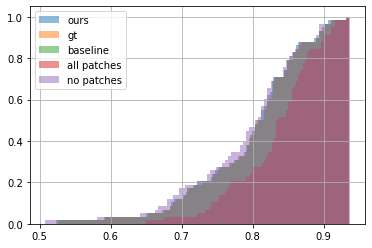

In [299]:
import matplotlib.pyplot as plt

def get_selected_ssim(preds, test_df):
    our_patch_ssim = []
    for ind in preds.index:
        entry = test_df.loc[ind]
        our_patch_ssim.append(entry['pr_' + str(preds[ind]) + '_ssim'])
    return pd.Series(our_patch_ssim, index=test_df.index)


our_patch_ssim = get_selected_ssim(preds, test_df)
print(our_patch_ssim.describe())
our_patch_ssim.hist(cumulative=True, density=1, bins=100, alpha=0.5)
# plt.show()

print(test_df["best_patch_ssim"].describe())
test_df["best_patch_ssim"].hist(cumulative=True, density=1, bins=100, alpha=0.5)
# plt.show()
print(test_df["naive_best_patch_ssim"].describe())
test_df["naive_best_patch_ssim"].hist(cumulative=True, density=1, bins=100, alpha=0.5)
# plt.show()

print(test_df["lr_ssim"].describe())
test_df["lr_ssim"].hist(cumulative=True, density=1, bins=100, alpha=0.5)
# plt.show()

print(test_df["cr_ssim"].describe())
test_df["cr_ssim"].hist(cumulative=True, density=1, bins=100, alpha=0.5)
plt.legend(['ours', 'gt', 'baseline', 'all patches', 'no patches'])
plt.show()


Mean and variance of compressed SSIM on test

Mean and variance of baseline SSIM on test

Mean and variance of model SSIM on test

CDFs

Some qualitative examples of best cases and failure cases

How often did baseline and mode disagree?

Bar graph of most common segment chosen

Graph of amount of space saved vs. performance gained

Average amount of space for compressed, baseline and model

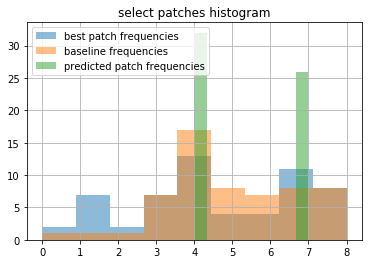

In [315]:
# # most common segment chose
alpha = 0.5
test_df['best_patch'].hist(bins=9, alpha=alpha)
# plt.show()

test_df['naive_best_patch'].hist(bins=9, alpha=alpha)
# plt.show()

preds.hist(bins=9, alpha=alpha)
plt.title("select patches histogram")
plt.legend([
    "best patch frequencies",
    "baseline frequencies",
    "predicted patch frequencies"
])


count    5.800000e+01
mean     8.725068e+05
std      2.697131e+05
min      3.430750e+05
25%      6.867355e+05
50%      8.772050e+05
75%      1.063849e+06
max      1.476565e+06
dtype: float64
count    5.800000e+01
mean     8.701332e+05
std      2.708091e+05
min      3.340810e+05
25%      6.865235e+05
50%      8.920860e+05
75%      1.067088e+06
max      1.483556e+06
dtype: float64
count    5.800000e+01
mean     8.696480e+05
std      2.710368e+05
min      3.340810e+05
25%      6.871740e+05
50%      8.765190e+05
75%      1.064455e+06
max      1.483556e+06
dtype: float64
count    5.800000e+01
mean     1.104370e+06
std      2.191237e+05
min      6.488070e+05
25%      9.752232e+05
50%      1.102062e+06
75%      1.259512e+06
max      1.634812e+06
Name: lr_filesize, dtype: float64
count        58.000000
mean      78469.103448
std       25437.051482
min       30989.000000
25%       60677.000000
50%       73675.000000
75%       94261.750000
max      152223.000000
Name: cr_filesize, dtype: float64

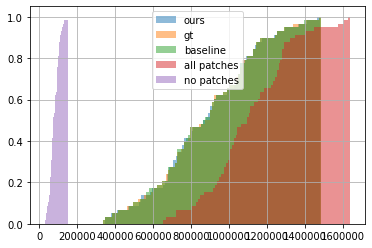

In [303]:
def get_selected_filesize(preds, test_df):
    our_patch_filesize = []
    for ind in preds.index:
        entry = test_df.loc[ind]
        our_patch_filesize.append(entry['pr_' + str(preds[ind]) + '_filesize'])
    return pd.Series(our_patch_filesize, index=test_df.index)

our_patch_filesize = get_selected_filesize(preds, test_df)
print(our_patch_filesize.describe())
our_patch_filesize.hist(cumulative=True, density=1, bins=100, alpha=0.5)
# plt.show()

best_patch_filesize = get_selected_filesize(test_df["best_patch"], test_df)
print(best_patch_filesize.describe())
best_patch_filesize.hist(cumulative=True, density=1, bins=100, alpha=0.5)
# plt.show()

naive_best_patch_filesize = get_selected_filesize(test_df["naive_best_patch"], test_df)
print(naive_best_patch_filesize.describe())
naive_best_patch_filesize.hist(cumulative=True, density=1, bins=100, alpha=0.5)
# plt.show()

print(test_df["lr_filesize"].describe())
test_df["lr_filesize"].hist(cumulative=True, density=1, bins=100, alpha=0.5)
# plt.show()

print(test_df["cr_filesize"].describe())
test_df["cr_filesize"].hist(cumulative=True, density=1, bins=100, alpha=0.5)
plt.legend(['ours', 'gt', 'baseline', 'all patches', 'no patches'])
plt.show()

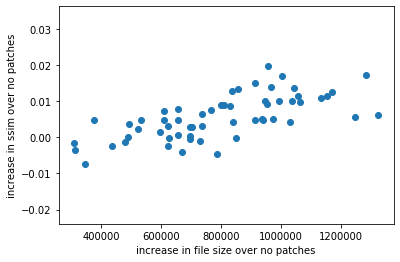

In [304]:
plt.scatter(our_patch_filesize - test_df['cr_filesize'], our_patch_ssim - test_df['cr_ssim'])
plt.xlabel("increase in file size over no patches")
plt.ylabel("increase in ssim over no patches")
plt.show()

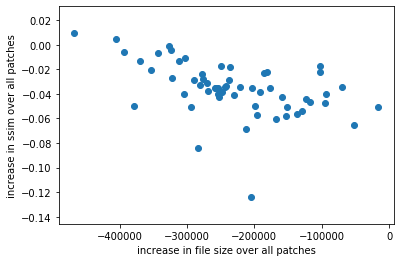

In [305]:
plt.scatter(our_patch_filesize - test_df['lr_filesize'], our_patch_ssim - test_df['lr_ssim'])
plt.xlabel("increase in file size over all patches")
plt.ylabel("increase in ssim over all patches")
plt.show()

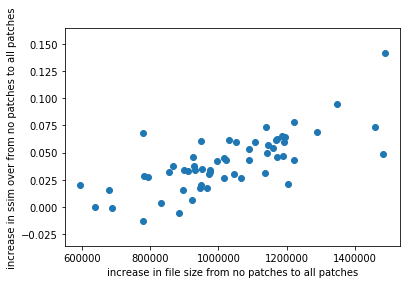

In [306]:
plt.scatter(test_df['lr_filesize'] - test_df['cr_filesize'], test_df['lr_ssim'] - test_df['cr_ssim'])
plt.xlabel("increase in file size from no patches to all patches")
plt.ylabel("increase in ssim over from no patches to all patches")
plt.show()

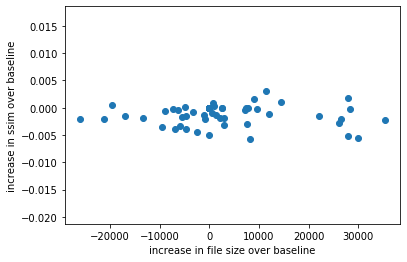

In [307]:
plt.scatter(our_patch_filesize - naive_best_patch_filesize, our_patch_ssim - test_df["naive_best_patch_ssim"])
plt.xlabel("increase in file size over baseline")
plt.ylabel("increase in ssim over baseline")
plt.show()

In [308]:
# number of agreements vs disagreements
series_list = [preds, test_df['best_patch'], test_df['naive_best_patch']]
names = ['ours', 'gt', 'baseline']

for name_a, series_a in zip(names, series_list):
    for name_b, series_b in zip(names, series_list):
        if name_a >= name_b:
            continue
        print("agreements between", name_a, "and", name_b, ":", (series_a == series_b).sum())
        print("disagreements between", name_a, "and", name_b, ":", (series_a != series_b).sum())

agreements between gt and ours : 12
disagreements between gt and ours : 46
agreements between baseline and ours : 11
disagreements between baseline and ours : 47
agreements between baseline and gt : 24
disagreements between baseline and gt : 34


our advantage amount on image 261 with patch 4: 0.00298213343264353


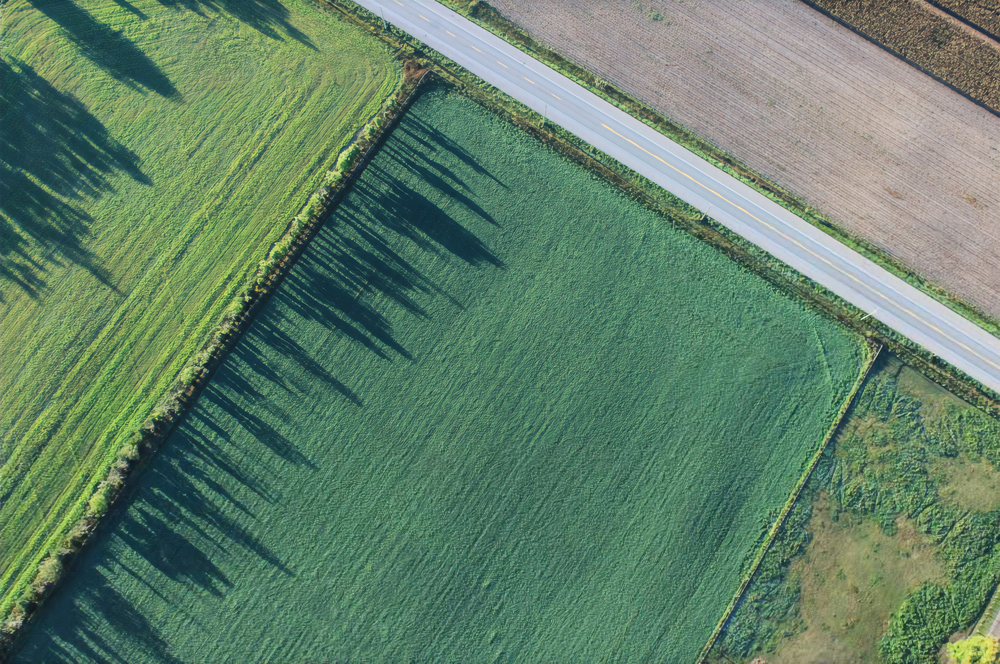

In [316]:
our_advantage = our_patch_ssim - test_df["naive_best_patch_ssim"]
our_advantage = our_advantage.sort_values()
pr_x2_dir = "div2k/DIV2K_train_LR_bicubic/CR_50_x2"
# Best image
best_id = our_advantage.index[-1]
print("our advantage amount on image {} with patch {}: {}".format(best_id, preds[int(best_id)], our_advantage.iloc[-1]))
our_img = Image.open(os.path.join(pr_x2_dir, '0' + str(best_id) + 'x2_' + str(preds[int(best_id)]) + '.png'))
our_img

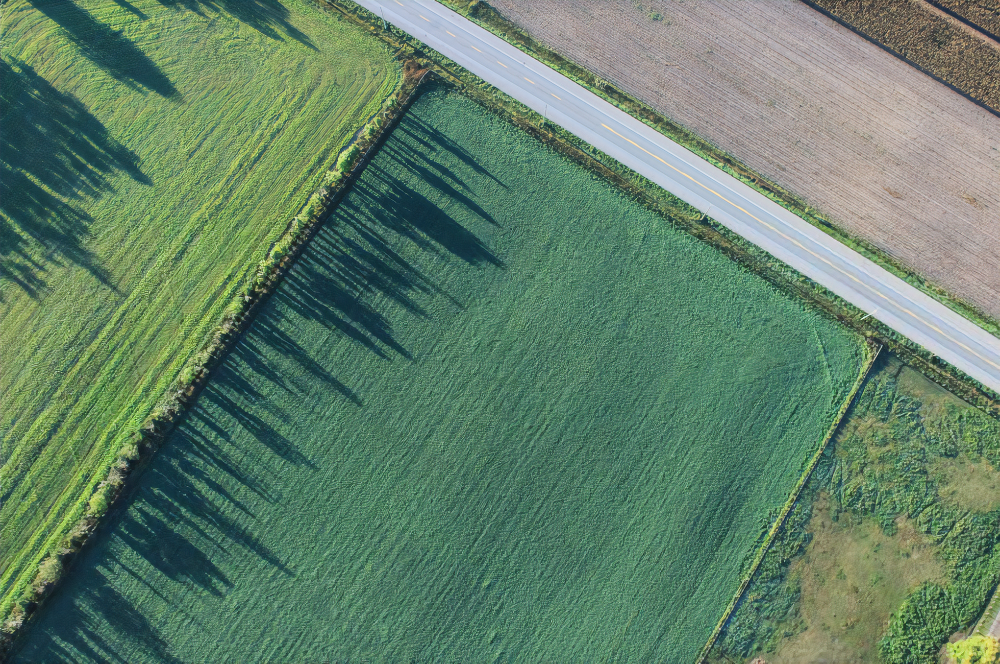

In [310]:
baseline_img = Image.open(os.path.join(pr_x2_dir, '0' + str(best_id) + 'x2_' + str(test_df['naive_best_patch'].loc[best_id]) + '.png'))
baseline_img

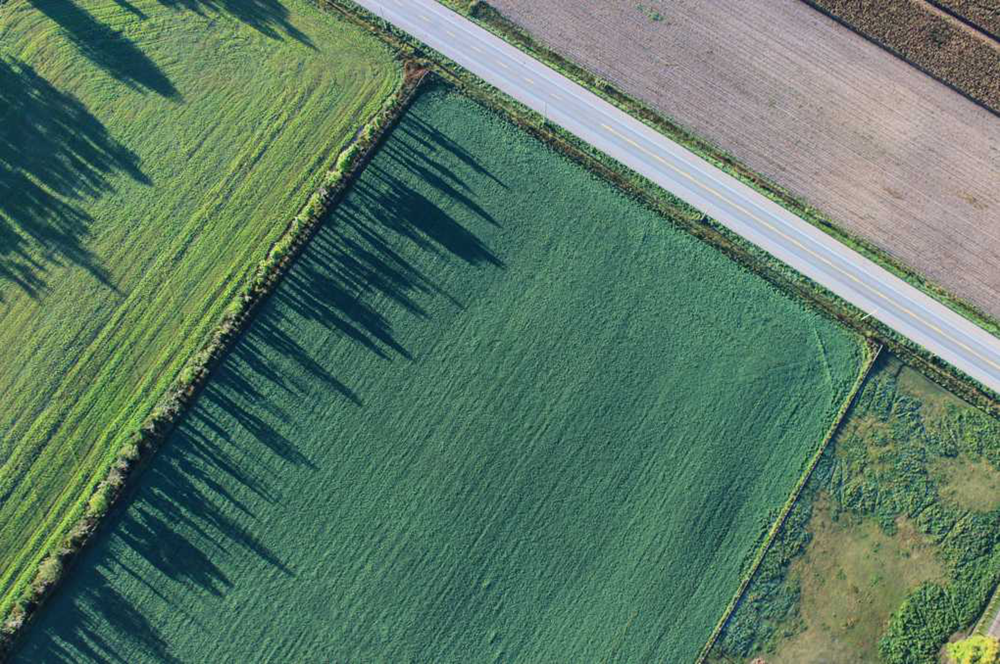

In [311]:
compressed_img = Image.open(os.path.join(train_cr_dir, '0' + str(best_id) + 'x2.jpeg'))
compressed_img.resize(size=(compressed_img.size[0]*2, compressed_img.size[1]*2), resample=Image.BICUBIC)

our disadvantage amount on image 209: -0.005678813008103023


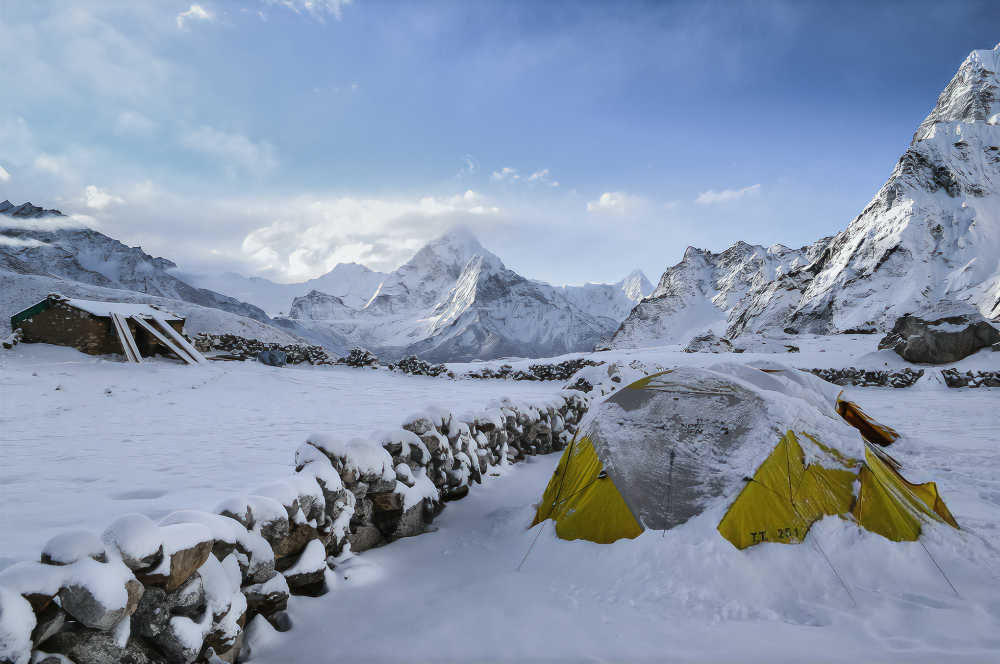

In [312]:
# Worst image
worst_id = our_advantage.index[0]
print("our disadvantage amount on image {}: {}".format(worst_id, our_advantage.iloc[0]))

our_img = Image.open(os.path.join(pr_x2_dir, '0' + str(worst_id) + 'x2_' + str(preds[int(worst_id)]) + '.png'))
our_img

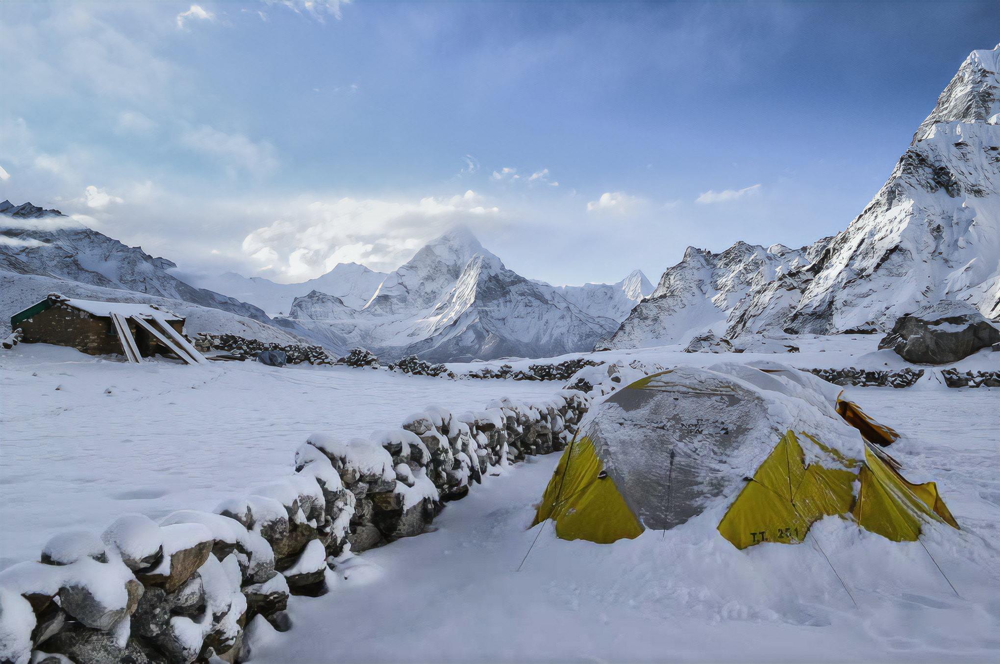

In [313]:
baseline_img = Image.open(os.path.join(pr_x2_dir, '0' + str(worst_id) + 'x2_' + str(test_df['naive_best_patch'].loc[worst_id]) + '.png'))
baseline_img

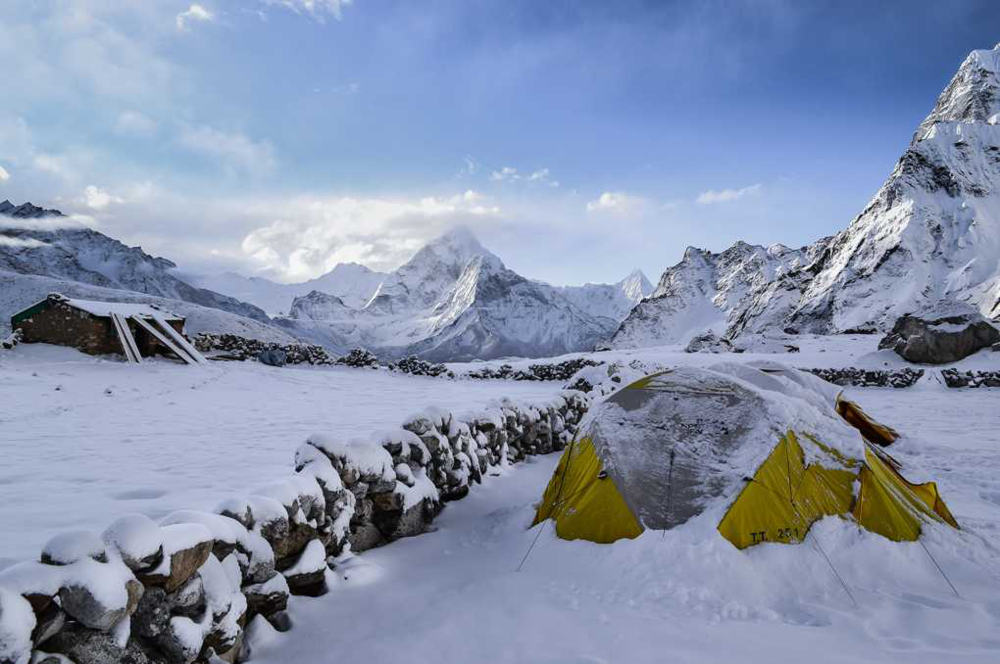

In [314]:
compressed_img = Image.open(os.path.join(train_cr_dir, '0' + str(worst_id) + 'x2.jpeg'))
compressed_img.resize(size=(compressed_img.size[0]*2, compressed_img.size[1]*2), resample=Image.BICUBIC)